C:\Users\abinj\AppData\Local\Temp\ipykernel_4428\2112491327.py:34: RuntimeWarning: overflow encountered in exp
  return np.cos(m * np.pi * x / a) * np.cos(n * np.pi * y / b) * np.exp(1j*omega*t-1* beta * z)
C:\Users\abinj\AppData\Local\Temp\ipykernel_4428\2112491327.py:34: RuntimeWarning: invalid value encountered in multiply
  return np.cos(m * np.pi * x / a) * np.cos(n * np.pi * y / b) * np.exp(1j*omega*t-1* beta * z)
C:\Users\abinj\AppData\Local\Temp\ipykernel_4428\2112491327.py:40: RuntimeWarning: overflow encountered in exp
  return -(np.exp(1j*np.pi/2) * eta * lambda_ * (m * np.pi / a)) *  np.sin(m * np.pi * x / a) * np.cos(n * np.pi * y / b) * np.exp(1j*omega*t-1* beta * z)
C:\Users\abinj\AppData\Local\Temp\ipykernel_4428\2112491327.py:40: RuntimeWarning: invalid value encountered in multiply
  return -(np.exp(1j*np.pi/2) * eta * lambda_ * (m * np.pi / a)) *  np.sin(m * np.pi * x / a) * np.cos(n * np.pi * y / b) * np.exp(1j*omega*t-1* beta * z)
C:\Users\abinj\AppData\Local\Temp\

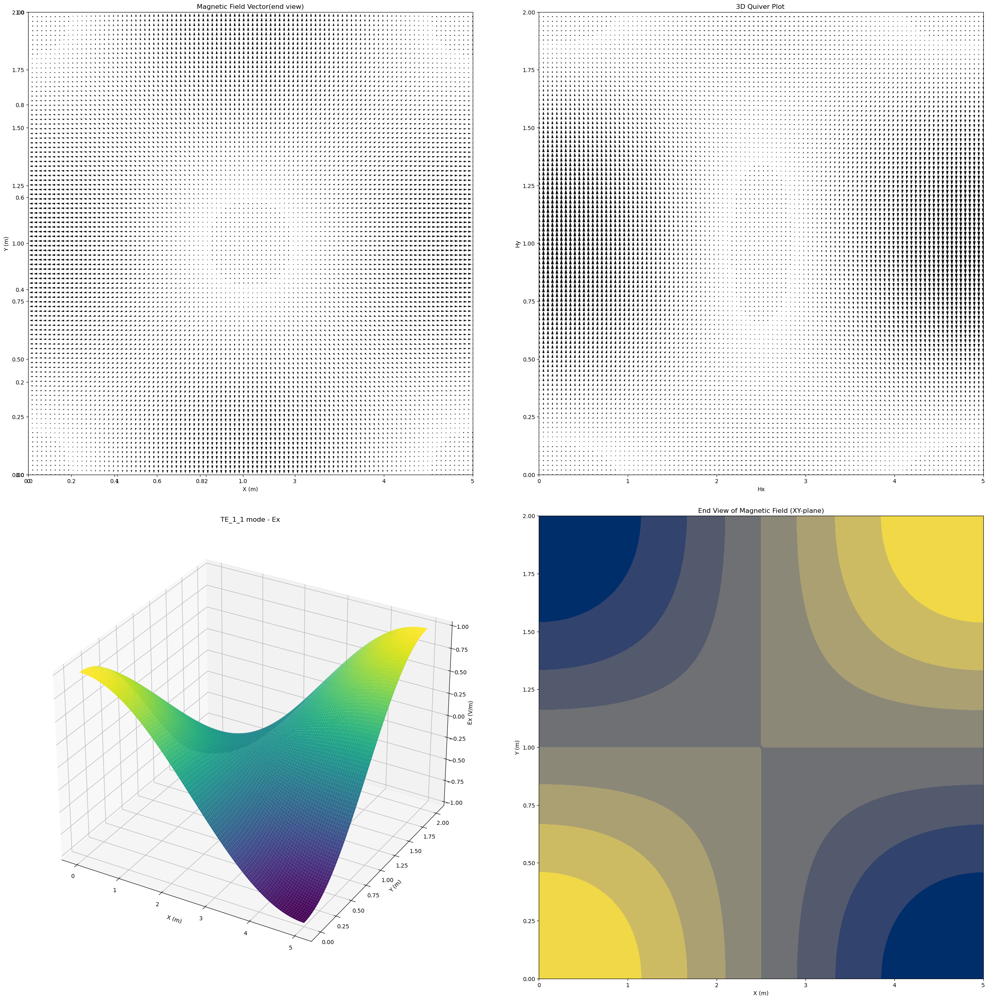

In [2]:
#####TE#############

import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from scipy.optimize import fsolve
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.mplot3d.art3d import Poly3DCollection

# Parameters
a = 5  # Waveguide width
b = 2  # Waveguide height
c= 10 #depth
m, n = 1,1  # TE_mn mode (change for other modes)
f = 10e9  # Frequency (Hz)
epsilon = 8.854e-12  # Permittivity
mu = 4e-7 * np.pi  # Permeability

lambda_ = (3 * (10**8)) / f
eta = np.sqrt(mu / epsilon)
omega = 2 * np.pi * f
k = omega * np.sqrt(mu * epsilon)

H=(np.pi * m / a)**2 +(np.pi * n / b)**2

# Characteristic equation and solve for beta
def char_eqn(beta):
    return k**2 -(np.pi * m / a)**2 - (np.pi * n / b)**2 -beta**2

beta = fsolve(char_eqn, 0)[0]

# Define field expressions for Ez
def Hz(x, y, z,t):
    return np.cos(m * np.pi * x / a) * np.cos(n * np.pi * y / b) * np.exp(1j*omega*t-1* beta * z)
def Ex(x, y, z, t):
    return (np.exp(1j*np.pi/2) * omega * mu * np.pi * n / (4 * np.pi**2 * b)) *  np.cos(m * np.pi * x / a) * np.sin(n * np.pi * y/ b) * np.exp(1j*omega*t-1* beta * z)
def Ey(x, y, z,t):
    return -(np.exp(1j*np.pi/2) * omega * mu * np.pi * m / (4 * np.pi**2 * a)) *  np.sin(m * np.pi * x / a) * np.cos(n * np.pi * y / b) *  np.exp(1j*omega*t-1* beta * z)
def Hx(x, y, z,t):
    return -(np.exp(1j*np.pi/2) * eta * lambda_ * (m * np.pi / a)) *  np.sin(m * np.pi * x / a) * np.cos(n * np.pi * y / b) * np.exp(1j*omega*t-1* beta * z)
def Hy(x, y, z,t):
    return np.exp(1j*np.pi/2) * eta * lambda_ * (n * np.pi / a) *  np.cos(m * np.pi * x / a) * np.sin(n * np.pi * y / b) * np.exp(1j*omega*t-1* beta * z)

# Create a meshgrid for the waveguide
x = np.linspace(0, a, 100)
y = np.linspace(0, b, 100)
z = np.linspace(0, c, 50)  # Depth from 0 to 1, you can adjust this based on your requirements
t = np.linspace(0, 100, 50)
X, Y, Z, T = np.meshgrid(x, y, z, t)

# Evaluate Hz at each point in the meshgrid
ez_values = Hz(X, Y, Z, T)
hx_values = Hx(X, Y, Z, T)
hy_values = Hy(X, Y, Z, T)
ex_values = Ex(X, Y, Z, T)
ey_values = Ey(X, Y, Z, T)

# Create a 3D plot
fig = plt.figure(figsize=(25,25))
ax = fig.add_subplot(241)

# Add quiver plot subplot
ax_quiver = fig.add_subplot(221)
ax_quiver.quiver(X[:,:,0,0].flatten(), Y[:,:,0,0].flatten(), hx_values[:,:,0,0].flatten(), hy_values[:,:,0,0].flatten(),  color='black')
# for i in range(len(t)):
#     ax_quiver.contourf(X[:,:,0,i], Y[:,:,0,i], np.abs(ez_values[:,:,0,i]), zdir='z', offset=t[i], cmap=cm.coolwarm, linewidths=1, alpha=0.5)
ax_quiver.set_xlabel('X (m)')
ax_quiver.set_ylabel('Y (m)')
ax_quiver.set_xlim([0, a])
ax_quiver.set_ylim([0, b])
# ax_quiver.set_zlim([0, c])
# ax_quiver.view_init(elev=20, azim=190, roll=90)
ax_quiver.set_title('Magnetic Field Vector(end view)')

# Add subplots for E feild
ax = fig.add_subplot(222)
ax.quiver(X[:,:,0,0].flatten(), Y[:,:,0,0].flatten(), ex_values[:,:,0,0].flatten(), ey_values[:,:,0,0].flatten(),color='black')  
ax.set_xlabel('Hx')
ax.set_ylabel('Hy')
ax.set_xlim([0, a])
ax.set_ylim([0, b])
ax.set_title('3D Quiver Plot ')

# 3D surface plot for Exs
ax_surf_ex = fig.add_subplot(223, projection='3d')
ax_surf_ex.plot_surface(X[:, :, 0, 0], Y[:, :, 0, 0], ez_values[:, :, 0, 0], cmap=cm.viridis, rstride=1, cstride=1, linewidth=0)
# ax_surf_ex.quiver(X[:, :, 0, 0], Y[:, :, 0, 0],Z[:,:,0,0], hx_values[:,:,0,0], hy_values[:,:,0,0], ez_values[:,:,0,0],color='black')  # Set arrow length here
ax_surf_ex.set_xlabel('X (m)')
ax_surf_ex.set_ylabel('Y (m)')
ax_surf_ex.set_zlabel('Ex (V/m)')
ax_surf_ex.set_title('TE_{}_{} mode - Hz'.format(m, n))

ax_end = fig.add_subplot(224)
ax_end.contourf(X[:,:,0,0], Y[:,:,0,0], ez_values[:,:,0,0].real, cmap=cm.cividis)
ax_end.set_xlabel('X (m)')
ax_end.set_ylabel('Y (m)')
ax_end.set_title('End View of Magnetic Field (XY-plane)')

plt.tight_layout()
plt.show()

c:\Users\abinj\anaconda3\envs\DIP\lib\site-packages\scipy\optimize\_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


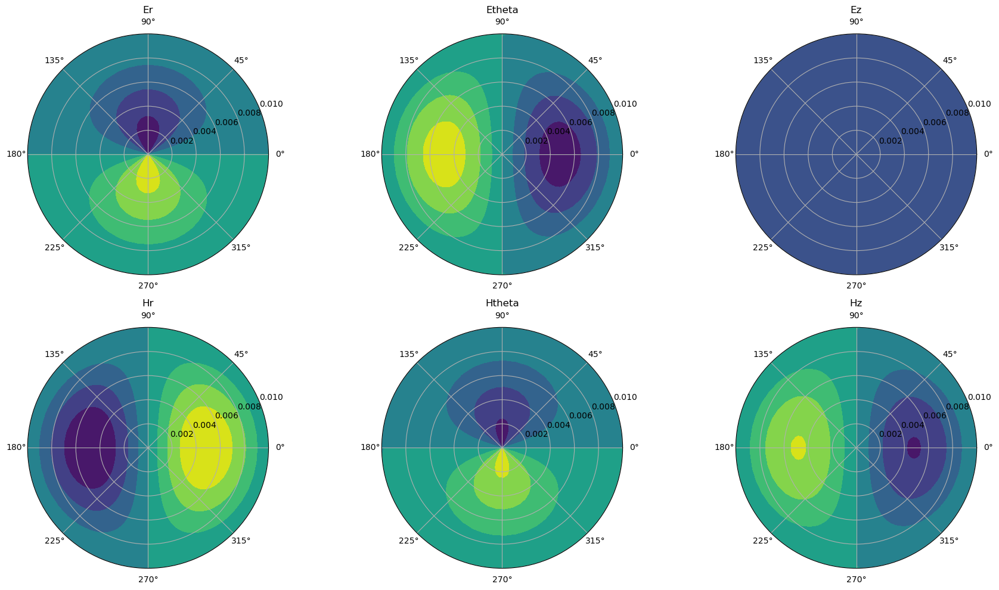

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import fsolve
from matplotlib import cm
from scipy.special import jn, jn_zeros

# Parameters
R = 0.01  # Inner radius of the waveguide (modify as needed)
c = 10  # Depth
m = 1 # TE_mn mode (m is an integer for cylindrical symmetry)
f = 8.79e9  # Cut-off frequency for TE11 mode (Hz) - modify as needed
epsilon_r = 1  # Relative permittivity
mu = 4e-7 * np.pi  # Permeability

# Calculate angular frequency and wave number
omega = 2 * np.pi * f
k = omega * np.sqrt(mu*epsilon_r)

# Calculate the waveguide mode parameter kc
k_c = jn_zeros(m, 1)[0] / R

def char_eqn(beta):
    return (beta**2 - k**2) * epsilon_r - k_c**2

beta = fsolve(char_eqn, 0)[0]

k_g = beta


A = 1

# Define field expressions for Electric field components in cylindrical coordinates
def Er(r, theta, z,t):
    return (m * A * jn(m, k_c * r) * np.sin(m * theta)/r)* np.exp(1j*(-omega*t+1* k_g * z))

def Etheta(r, theta, z,t):
    return k_c * A * jn(m, k_c * r) * np.cos(m * theta)* np.exp(1j*(-omega*t+1* k_g * z))

def Ez(r, theta, z,t):
    return np.zeros_like(r)  # Electric field component Ez is zero

# Magnetic field components
def Hr(r, theta, z,t):
    return -(k_g * k_c /(omega*mu)) * A * jn(m, k_c * r) * np.cos(m * theta)* np.exp(1j*(-omega*t+1* k_g * z))

def Htheta(r, theta, z,t):
    return (k_g / (omega *mu))* (m * A /r) * jn(m, k_c * r) * np.sin(m * theta)* np.exp(1j*(-omega*t+1* k_g * z))

def Hz(r, theta, z,t):
    return 1j*(k_c**2 / (omega *mu))* A * jn(m, k_c * r) * np.cos(m * theta)* np.exp(1j*(-omega*t+1* k_g * z))

# Generate polar grid points
Nr, Ntheta, Nz,Nt = 50, 50, 50,50
r = np.linspace(0.00001, R, Nr)
theta = np.linspace(0, 2 * np.pi, Ntheta)
z = np.linspace(0, c, Nz)
t = np.linspace(0, 100, Nt)
R, Theta, Z,T = np.meshgrid(r, theta, z,t, indexing='ij')

# Calculate field magnitudes at grid points
er = Er(R, Theta, Z,T)
etheta = Etheta(R, Theta, Z,T)
ez = Ez(R, Theta, Z,T)
hr = Hr(R, Theta, Z,T)
htheta = Htheta(R, Theta, Z,T)
hz = Hz(R, Theta, Z,T)

# Create polar plots for Er, Etheta, Ez, Hr, Htheta, Hz
fig, axs = plt.subplots(2, 3, figsize=(18, 10), subplot_kw={'projection': 'polar'})

plots = [(er, 'Er'), (etheta, 'Etheta'), (ez, 'Ez'), (hr, 'Hr'), (htheta, 'Htheta'), (hz, 'Hz')]

for ax, (field, title) in zip(axs.flatten(), plots):
    ax.contourf(Theta[:, :, 0,33], R[:, :, 0,33], field[:, :, 0,33].real, cmap=cm.viridis)
    ax.set_title(title)

plt.tight_layout()
plt.show()


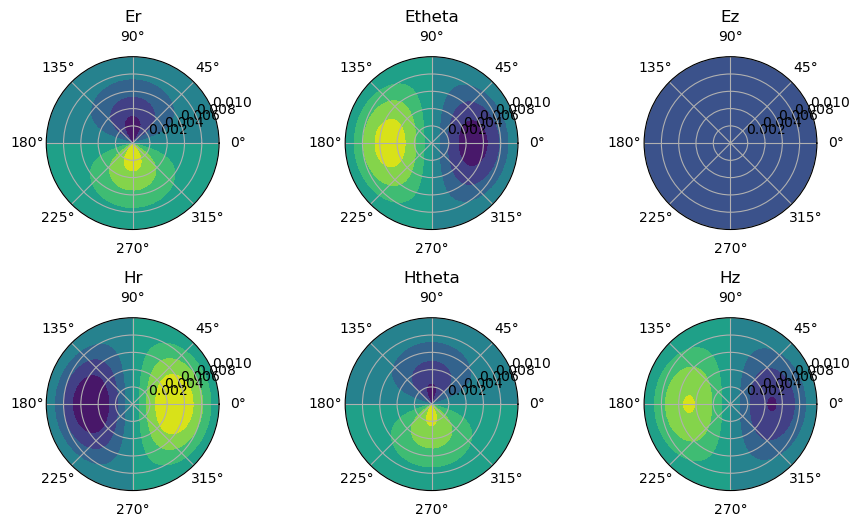

In [5]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import fsolve,root
from matplotlib import cm
from scipy.special import jn, jn_zeros

# Parameters
R = 0.01  # Inner radius of the waveguide (modify as needed)
c = 10  # Depth
m = 1 # TE_mn mode (m is an integer for cylindrical symmetry)
f = 8.79e9  # Cut-off frequency for TE11 mode (Hz) - modify as needed
epsilon_r = 1  # Relative permittivity
mu = 4e-7 * np.pi  # Permeability

# Calculate angular frequency and wave number
omega = 2 * np.pi * f
k = omega * np.sqrt(mu*epsilon_r)

# Calculate the waveguide mode parameter kc
k_c = jn_zeros(m, 1)[0] / R

def char_eqn_scaled(beta):
    # Scale the equation if necessary
    return (beta**2 - k**2) * epsilon_r - k_c**2

# beta = fsolve(char_eqn_scaled, 0.1)[0]
result = root(char_eqn_scaled, x0=0.1 ,method='hybr')
beta = result.x[0]

k_g = beta


A = 1

# Define field expressions for Electric field components in cylindrical coordinates
def Er(r, theta, z,t):
    return (m * A * jn(m, k_c * r) * np.sin(m * theta)/r)* np.exp(1j*(-omega*t+1* k_g * z))

def Etheta(r, theta, z,t):
    return k_c * A * jn(m, k_c * r) * np.cos(m * theta)* np.exp(1j*(-omega*t+1* k_g * z))

def Ez(r, theta, z,t):
    return np.zeros_like(r)  # Electric field component Ez is zero

# Magnetic field components
def Hr(r, theta, z,t):
    return -(k_g * k_c /(omega*mu)) * A * jn(m, k_c * r) * np.cos(m * theta)* np.exp(1j*(-omega*t+1* k_g * z))

def Htheta(r, theta, z,t):
    return (k_g / (omega *mu))* (m * A /r) * jn(m, k_c * r) * np.sin(m * theta)* np.exp(1j*(-omega*t+1* k_g * z))

def Hz(r, theta, z,t):
    return 1j*(k_c**2 / (omega *mu))* A * jn(m, k_c * r) * np.cos(m * theta)* np.exp(1j*(-omega*t+1* k_g * z))

# Generate polar grid points
Nr, Ntheta, Nz,Nt = 50, 50, 50,50
r = np.linspace(0.00001, R, Nr)
theta = np.linspace(0, 2 * np.pi, Ntheta)
z = np.linspace(0, c, Nz)
t = np.linspace(0, 100, Nt)
R, Theta, Z,T = np.meshgrid(r, theta, z,t, indexing='ij')

# Calculate field magnitudes at grid points
er = Er(R, Theta, Z,T)
etheta = Etheta(R, Theta, Z,T)
ez = Ez(R, Theta, Z,T)
hr = Hr(R, Theta, Z,T)
htheta = Htheta(R, Theta, Z,T)
hz = Hz(R, Theta, Z,T)

fig = plt.figure(figsize=(9.1175, 5.3708333333))

ax0 = fig.add_subplot(231, polar=True)
ax1 = fig.add_subplot(232, polar=True)
ax2 = fig.add_subplot(233, polar=True)
ax3 = fig.add_subplot(234, polar=True)
ax4 = fig.add_subplot(235, polar=True)
ax5 = fig.add_subplot(236, polar=True)

# ax0.clear()
ax0.contourf(Theta[:, :, 0,33], R[:, :, 0,33], er[:, :, 0,33].real, cmap=cm.viridis)
ax0.set_title('Er')

# ax1.clear()
ax1.contourf(Theta[:, :, 0,33], R[:, :, 0,33], etheta[:, :, 0,33].real, cmap=cm.viridis)
ax1.set_title('Etheta')

# ax2.clear()
ax2.contourf(Theta[:, :, 0,33], R[:, :, 0,33], ez[:, :, 0,33].real, cmap=cm.viridis)
ax2.set_title('Ez')

# ax3.clear()
ax3.contourf(Theta[:, :, 0,33], R[:, :, 0,33], hr[:, :, 0,33].real, cmap=cm.viridis)
ax3.set_title('Hr')

# ax4.clear()
ax4.contourf(Theta[:, :, 0,33], R[:, :, 0,33], htheta[:, :, 0,33].real, cmap=cm.viridis)
ax4.set_title('Htheta')

# ax5.clear()
ax5.contourf(Theta[:, :, 0,33], R[:, :, 0,33], hz[:, :, 0,33].real, cmap=cm.viridis)
ax5.set_title('Hz')

plt.tight_layout()
plt.show()


In [17]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from scipy.optimize import fsolve
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.mplot3d.art3d import Poly3DCollection

# Parameters
a = 5  # Waveguide width
b = 2  # Waveguide height
c= 10 #depth
m, n = 1, 3  # TE_mn mode (change for other modes)
f = 10e9  # Frequency (Hz)
epsilon = 8.854e-12  # Permittivity
mu = 4e-7 * np.pi  # Permeability

lambda_ = (3 * (10**8)) / f
eta = np.sqrt(mu / epsilon)
omega = 2 * np.pi * f
k = omega * np.sqrt(mu * epsilon)

# Characteristic equation and solve for beta
def char_eqn(beta):
    return k**2 -(np.pi * m / a)**2 - (np.pi * n / b)**2 -beta**2

beta = fsolve(char_eqn, 0)[0]

# Define field expressions for Hz
def Hz(x, y, z):
    return np.cos(m * np.pi * x / a) * np.cos(n * np.pi * y / b) * np.exp(-1j * beta * z)
def Hx(x, y, z):
    return -(np.exp(1j*np.pi/2) * eta * lambda_ * (m * np.pi / a)) *  np.sin(m * np.pi * x / a) * np.cos(n * np.pi * y / b) * np.exp(-1j * beta * z)
def Hy(x, y, z):
    return np.exp(1j*np.pi/2) * eta * lambda_ * (n * np.pi / a) *  np.cos(m * np.pi * x / a) * np.sin(n * np.pi * y / b) * np.exp(-1j * beta * z)
def Ex(x, y, z):
    return (np.exp(1j*np.pi/2) * omega * mu * np.pi * n / (4 * np.pi**2 * b)) *  np.cos(m * np.pi * x / a) * np.sin(n * np.pi * y/ b) * np.exp(-1j * beta * z)
def Ey(x, y, z):
    return -(np.exp(1j*np.pi/2) * omega * mu * np.pi * m / (4 * np.pi**2 * a)) *  np.sin(m * np.pi * x / a) * np.cos(n * np.pi * y / b) * np.exp(-1j * beta * z)

# Create a meshgrid for the waveguide
x = np.linspace(0, a, 100)
y = np.linspace(0, b, 100)
z = np.linspace(0, c, 50)  # Depth from 0 to 1, you can adjust this based on your requirements

X, Y, Z = np.meshgrid(x, y, z)

# Evaluate Hz at each point in the meshgrid
hz_values = Hz(X, Y, Z) # Take real part for plotting
hx_values = Hx(X, Y, Z)
hy_values = Hy(X, Y, Z)
ex_values = Ex(X, Y, Z)
ey_values = Ey(X, Y, Z)
ez_values = 0
# Create a 3D plot
fig = plt.figure(figsize=(100, 60))
ax = fig.add_subplot(241, projection='3d')

def plot_cuboid(a, b, c):

    # Define the eight vertices of the cuboid
    vertices = [
        (0, 0, 0),
        (a, 0, 0),
        (a, b, 0),
        (0, b, 0),
        (0, 0, c),
        (a, 0, c),
        (a, b, c),
        (0, b, c)
    ]

    # Define the six faces of the cuboid using the vertices
    faces = [
        [vertices[0], vertices[1], vertices[5], vertices[4]],
        [vertices[7], vertices[6], vertices[2], vertices[3]],
        [vertices[0], vertices[4], vertices[7], vertices[3]],
        [vertices[1], vertices[5], vertices[6], vertices[2]],
        [vertices[4], vertices[5], vertices[6], vertices[7]],
        [vertices[0], vertices[1], vertices[2], vertices[3]]
    ]

    return faces

faces=plot_cuboid(a, b, c)

# Plot the Hz field as contour plots across depth
for i in range(len(z)):
    ax.contourf(X[:,:,i], Y[:,:,i], np.abs(hz_values[:,:,i]), zdir='z', offset=z[i], cmap=cm.coolwarm, linewidths=1, alpha=0.5)

# Create a Poly3DCollection object and add it to the plot
ax.add_collection3d(Poly3DCollection(faces, facecolors='grey', linewidths=1, alpha=0.3))
ax.set_xlim([0, 2*a])
ax.set_ylim([0, 2*b])
ax.set_zlim([0, c])
ax.set_xlabel('X-axis')
ax.set_ylabel('Y-axis')
ax.set_zlabel('Z-axis')
ax.view_init(elev=20, azim=190, roll=90)
plt.axis('off')

# 3D surface plot subplot
ax_surf = fig.add_subplot(242, projection='3d')
surf0 = ax_surf.plot_surface(X[:,:,0], Y[:,:,0], hz_values[:,:,0], cmap=cm.coolwarm, rstride=1, cstride=1, linewidth=0)
ax_surf.set_xlabel('X (m)')
ax_surf.set_ylabel('Y (m)')
ax_surf.set_zlabel('Hz (V/m)')
ax_surf.set_title('TE_{}_{} mode in rectangular waveguide'.format(m, n))

####################################
ax_end = fig.add_subplot(243)
ax_end.contourf(X[:,:,0], Y[:,:,0], np.abs(hz_values[:,:,0]), cmap=cm.coolwarm)
ax_end.set_xlabel('X (m)')
ax_end.set_ylabel('Y (m)')
ax_end.set_title('End View of Magnetic Field (XY-plane)')

# Add quiver plot subplot
ax_quiver = fig.add_subplot(244)
ax_quiver.quiver(X[:,:,0], Y[:,:,0], hx_values[:,:,0], hy_values[:,:,0], scale=500, color='black', pivot='middle')
ax_quiver.set_xlabel('X (m)')
ax_quiver.set_ylabel('Y (m)')
ax_quiver.set_title('Magnetic Field Vector(end view)')

# Add subplots for E feild
ax = fig.add_subplot(245)
ax.quiver(X[:,:,0], Y[:,:,0], ex_values[:,:,0], ey_values[:,:,0],color='black')  
ax.set_xlabel('Hx')
ax.set_ylabel('Hy')
ax.set_title('3D Quiver Plot ')

# 3D surface plot for Hz
ax = fig.add_subplot(246, projection='3d')
ax.quiver(X[:,:,0], Y[:,:,0],hz_values[:,:,0].real, hx_values[:,:,0], hy_values[:,:,0], hz_values[:,:,0], length=0.1,color='black')  # Set arrow length here
ax.set_xlabel('Hx')
ax.set_ylabel('Hy')
ax.set_zlabel('Hz')
ax.set_title('3D Quiver Plot ')

# 3D surface plot for Ex
ax_surf_ex = fig.add_subplot(247, projection='3d')
surf_ex = ax_surf_ex.plot_surface(X[:,:,0], Y[:,:,0], ex_values[:,:,0], cmap=cm.viridis, rstride=1, cstride=1, linewidth=0)
ax_surf_ex.set_xlabel('X (m)')
ax_surf_ex.set_ylabel('Y (m)')
ax_surf_ex.set_zlabel('Ex (V/m)')
ax_surf_ex.set_title('TE_{}_{} mode - Ex'.format(m, n))

# 3D surface plot for Ey
ax_surf_ey = fig.add_subplot(248, projection='3d')
surf_ey = ax_surf_ey.plot_surface(X[:,:,0], Y[:,:,0], ey_values[:,:,0], cmap=cm.plasma, rstride=1, cstride=1, linewidth=0)
ax_surf_ey.set_xlabel('X (m)')
ax_surf_ey.set_ylabel('Y (m)')
ax_surf_ey.set_zlabel('Ey (V/m)')
ax_surf_ey.set_title('TE_{}_{} mode - Ey'.format(m, n))

plt.tight_layout()
plt.show()

C:\Users\abinj\AppData\Local\Temp\ipykernel_10392\717350224.py:88: UserWarning: linewidths is ignored by contourf
  ax.contourf(X[:,:,i], Y[:,:,i], np.abs(hz_values[:,:,i]), zdir='z', offset=z[i], cmap=cm.coolwarm, linewidths=1, alpha=0.5)


c:\ProgramData\Anaconda3\envs\dip\lib\site-packages\scipy\optimize\_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
c:\ProgramData\Anaconda3\envs\dip\lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


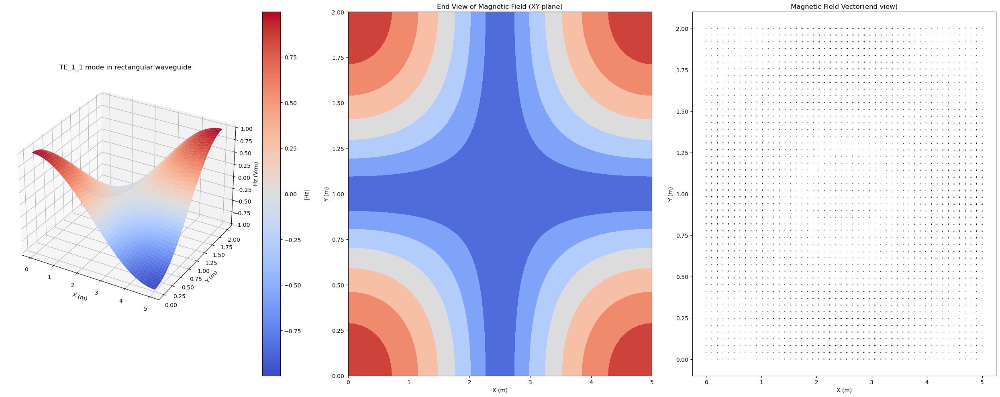

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import fsolve
from matplotlib import cm

# Parameters
a = 5  # Waveguide width
b = 2  # Waveguide height
m, n = 1,1  # TE_mn mode (change for other modes)
f = 10e9  # Frequency (Hz)
epsilon = 8.854e-12  # Permittivity
mu = 4e-7 * np.pi  # Permeability

# Calculate angular frequency and wave number
omega = 2 * np.pi * f
k = omega * np.sqrt(mu * epsilon)

# Characteristic equation and solve for beta
def char_eqn(beta):
    return (np.pi * m / a)**2 + (np.pi * n / b)**2 - k**2 - omega**2 * mu * epsilon

beta = fsolve(char_eqn, 0)[0]

# Define field expressions for Hz
def Hz(x, y):
    return np.cos(m * np.pi * x / a) * np.cos(n * np.pi * y / b) * np.exp(-1j * beta * x)

# Generate grid points
Nx, Ny = 50, 50
x = np.linspace(0, a, Nx)
y = np.linspace(0, b, Ny)
X, Y = np.meshgrid(x, y)

# Calculate Hz at grid points
Z = Hz(X, Y)

# Create 3D surface plot and quiver plot subplots
fig = plt.figure(figsize=(25, 10))


# Calculate Hx and Hy from Hz
h_x = -np.gradient(Z, axis=1)  # Calculate Hx from Hz
h_y = np.gradient(Z, axis=0)    # Calculate Hy from Hz

# 3D surface plot subplot
ax_surf = fig.add_subplot(131, projection='3d')
surf = ax_surf.plot_surface(X, Y, Z, cmap=cm.coolwarm, rstride=1, cstride=1, linewidth=0)
ax_surf.set_xlabel('X (m)')
ax_surf.set_ylabel('Y (m)')
ax_surf.set_zlabel('Hz (V/m)')
ax_surf.set_title('TE_{}_{} mode in rectangular waveguide'.format(m, n))

plt.colorbar(surf, label='|Hz|')

####################################
ax_end = fig.add_subplot(132)
ax_end.contourf(X, Y, np.abs(Z), cmap=cm.coolwarm)
ax_end.set_xlabel('X (m)')
ax_end.set_ylabel('Y (m)')
ax_end.set_title('End View of Magnetic Field (XY-plane)')


# Add quiver plot subplot
ax_quiver = fig.add_subplot(133)
ax_quiver.quiver(X, Y, h_x, h_y, scale=10, color='black', pivot='middle')
ax_quiver.set_xlabel('X (m)')
ax_quiver.set_ylabel('Y (m)')
ax_quiver.set_title('Magnetic Field Vector(end view)')
plt.tight_layout()
plt.show()


In [7]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from scipy.optimize import fsolve
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.mplot3d.art3d import Poly3DCollection

# Parameters
a = 5  # Waveguide width
b = 2  # Waveguide height
c= 10 #depth
m, n = 1, 1  # TE_mn mode (change for other modes)
f = 10e9  # Frequency (Hz)
epsilon = 8.854e-12  # Permittivity
mu = 4e-7 * np.pi  # Permeability

lambda_ = (3 * (10**8)) / f
eta = np.sqrt(mu / epsilon)
omega = 2 * np.pi * f
k = omega * np.sqrt(mu * epsilon)

# Characteristic equation and solve for beta
def char_eqn(beta):
    return (np.pi * m / a)**2 + (np.pi * n / b)**2 - k**2 - omega**2 * mu * epsilon

beta = fsolve(char_eqn, 0)[0]

# Define field expressions for Hz
def Hz(x, y, z):
    return np.cos(m * np.pi * x / a) * np.cos(n * np.pi * y / b) * np.exp(-1j * beta * z)
def Hx(x, y, z):
    return -(np.exp(1j*np.pi/2) * eta * lambda_ * (m * np.pi / a)) *  np.sin(m * np.pi * x / a) * np.cos(n * np.pi * y / b) * np.exp(-1j * beta * z)
def Hy(x, y, z):
    return np.exp(1j*np.pi/2) * eta * lambda_ * (n * np.pi / a) *  np.cos(m * np.pi * x / a) * np.sin(n * np.pi * y / b) * np.exp(-1j * beta * z)
def Ex(x, y, z):
    return (np.exp(1j*np.pi/2) * omega * mu * np.pi * n / (4 * np.pi**2 * b)) *  np.cos(m * np.pi * x / a) * np.sin(n * np.pi * y/ b) * np.exp(-1j * beta * z)
def Ey(x, y, z):
    return -(np.exp(1j*np.pi/2) * omega * mu * np.pi * m / (4 * np.pi**2 * a)) *  np.sin(m * np.pi * x / a) * np.cos(n * np.pi * y / b) * np.exp(-1j * beta * z)

# Create a meshgrid for the waveguide
x = np.linspace(0, a, 100)
y = np.linspace(0, b, 100)
z = np.linspace(0, c, 50)  # Depth from 0 to 1, you can adjust this based on your requirements

X, Y, Z = np.meshgrid(x, y, z)

# Evaluate Hz at each point in the meshgrid
hz_values = Hz(X, Y, Z) # Take real part for plotting
hx_values = Hx(X, Y, Z)
hy_values = Hy(X, Y, Z)
ex_values = Ex(X, Y, Z).real
ey_values = Ey(X, Y, Z).real
# Create a 3D plot
fig = plt.figure(figsize=(100, 60))
ax = fig.add_subplot(241, projection='3d')

def plot_cuboid(a, b, c):

    # Define the eight vertices of the cuboid
    vertices = [
        (0, 0, 0),
        (a, 0, 0),
        (a, b, 0),
        (0, b, 0),
        (0, 0, c),
        (a, 0, c),
        (a, b, c),
        (0, b, c)
    ]

    # Define the six faces of the cuboid using the vertices
    faces = [
        [vertices[0], vertices[1], vertices[5], vertices[4]],
        [vertices[7], vertices[6], vertices[2], vertices[3]],
        [vertices[0], vertices[4], vertices[7], vertices[3]],
        [vertices[1], vertices[5], vertices[6], vertices[2]],
        [vertices[4], vertices[5], vertices[6], vertices[7]],
        [vertices[0], vertices[1], vertices[2], vertices[3]]
    ]

    return faces

faces=plot_cuboid(a, b, c)

# Plot the Hz field as contour plots across depth
for i in range(len(z)):
    ax.contourf(X[:,:,i], Y[:,:,i], np.abs(hz_values[:,:,i]), zdir='z', offset=z[i], cmap=cm.coolwarm, linewidths=1, alpha=0.5)

# Create a Poly3DCollection object and add it to the plot
ax.add_collection3d(Poly3DCollection(faces, facecolors='grey', linewidths=1, alpha=0.3))
ax.set_xlim([0, 2*a])
ax.set_ylim([0, 2*b])
ax.set_zlim([0, c])
ax.set_xlabel('X-axis')
ax.set_ylabel('Y-axis')
ax.set_zlabel('Z-axis')
ax.view_init(elev=20, azim=190, roll=90)
plt.axis('off')

# 3D surface plot subplot
ax_surf = fig.add_subplot(242, projection='3d')
surf0 = ax_surf.plot_surface(X[:,:,0], Y[:,:,0], hz_values[:,:,0], cmap=cm.coolwarm, rstride=1, cstride=1, linewidth=0)
ax_surf.set_xlabel('X (m)')
ax_surf.set_ylabel('Y (m)')
ax_surf.set_zlabel('Hz (V/m)')
ax_surf.set_title('TE_{}_{} mode in rectangular waveguide'.format(m, n))

####################################
ax_end = fig.add_subplot(243)
ax_end.contourf(X[:,:,0], Y[:,:,0], np.abs(hz_values[:,:,0]), cmap=cm.coolwarm)
ax_end.set_xlabel('X (m)')
ax_end.set_ylabel('Y (m)')
ax_end.set_title('End View of Magnetic Field (XY-plane)')

# Add quiver plot subplot
ax_quiver = fig.add_subplot(244)
ax_quiver.quiver(X[:,:,0], Y[:,:,0], hx_values[:,:,0], hy_values[:,:,0], scale=500, color='black', pivot='middle')
# ax_quiver.quiver(X, Y, Z1, Z2, scale=7000, color='red', pivot='middle')
ax_quiver.set_xlabel('X (m)')
ax_quiver.set_ylabel('Y (m)')
ax_quiver.set_title('Magnetic Field Vector(end view)')

# Add subplots for Ex,Ey
ax_ex = fig.add_subplot(245, projection='3d')
# surf0 = ax_ex.plot_surface(X, Y, Z0, cmap=cm.coolwarm, rstride=1, cstride=1, linewidth=0)
surf1 = ax_ex.plot_surface(X[:,:,0], Y[:,:,0], (ex_values[:,:,0]), color='black', rstride=1, cstride=1, linewidth=0,alpha=0.3)
surf2 = ax_ex.plot_surface(X[:,:,0], Y[:,:,0], (ey_values[:,:,0]), color='red', rstride=1, cstride=1, linewidth=0,alpha=0.5)
# surf3 = ax_ex.plot_surface(X, Y, (Z3), color='blue', rstride=1, cstride=1, linewidth=0)
# surf4 = ax_ex.plot_surface(X, Y, (Z4), color='red', rstride=1, cstride=1, linewidth=0)
ax_ex.set_xlabel('X (m)')
ax_ex.set_ylabel('Y (m)')
ax_ex.set_title('Z')

# 3D surface plot for Hz
ax = fig.add_subplot(246, projection='3d')
ax.quiver(X[:,:,0], Y[:,:,0],hz_values[:,:,0].real, hx_values[:,:,0], hy_values[:,:,0], hz_values[:,:,0], length=0.1,color='black')  # Set arrow length here
ax.set_xlabel('Hx')
ax.set_ylabel('Hy')
ax.set_zlabel('Hz')
ax.set_title('3D Quiver Plot ')

# 3D surface plot for Ex
ax_surf_ex = fig.add_subplot(247, projection='3d')
surf_ex = ax_surf_ex.plot_surface(X[:,:,0], Y[:,:,0], ex_values[:,:,0], cmap=cm.viridis, rstride=1, cstride=1, linewidth=0)
ax_surf_ex.set_xlabel('X (m)')
ax_surf_ex.set_ylabel('Y (m)')
ax_surf_ex.set_zlabel('Ex (V/m)')
ax_surf_ex.set_title('TE_{}_{} mode - Ex'.format(m, n))

# 3D surface plot for Ey
ax_surf_ey = fig.add_subplot(248, projection='3d')
surf_ey = ax_surf_ey.plot_surface(X[:,:,0], Y[:,:,0], ey_values[:,:,0], cmap=cm.plasma, rstride=1, cstride=1, linewidth=0)
ax_surf_ey.set_xlabel('X (m)')
ax_surf_ey.set_ylabel('Y (m)')
ax_surf_ey.set_zlabel('Ey (V/m)')
ax_surf_ey.set_title('TE_{}_{} mode - Ey'.format(m, n))

plt.tight_layout()
plt.show()

c:\ProgramData\Anaconda3\envs\dip\lib\site-packages\scipy\optimize\_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\abinj\AppData\Local\Temp\ipykernel_13884\3460470342.py:87: UserWarning: linewidths is ignored by contourf
  ax.contourf(X[:,:,i], Y[:,:,i], np.abs(hz_values[:,:,i]), zdir='z', offset=z[i], cmap=cm.coolwarm, linewidths=1, alpha=0.5)
